
## Project 2 (Introduction to DL)
**BREAST CANCER DIAGNOSIS (Pytorch Classification)**

### CS672 CRN 74071



Project Member
*   Rasika Gulhane


In [ ]:
! pip install ucimlrepo

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import torch
from sklearn.impute import SimpleImputer
from sklearn.ensemble import IsolationForest
from sklearn.preprocessing import RobustScaler

In [ ]:
from ucimlrepo import fetch_ucirepo


# fetch dataset
breast_cancer_wisconsin_diagnostic = fetch_ucirepo(id=17)

# data (as pandas dataframes)
X = breast_cancer_wisconsin_diagnostic.data.features
y = breast_cancer_wisconsin_diagnostic.data.targets

# Combine X and y into a DataFrame
df = pd.DataFrame(data=X)
df['diagnosis'] = y

# Display the first few rows of the DataFrame
df

,radius1,texture1,perimeter1,area1,smoothness1,compactness1,concavity1,concave_points1,symmetry1,fractal_dimension1,...,texture3,perimeter3,area3,smoothness3,compactness3,concavity3,concave_points3,symmetry3,fractal_dimension3,diagnosis
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,0.2419,0.07871,...,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890,M
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,0.1812,0.05667,...,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902,M
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,0.2069,0.05999,...,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758,M
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,0.2597,0.09744,...,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300,M
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,0.1809,0.05883,...,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678,M
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,0.05623,...,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115,M
565,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,0.1752,0.05533,...,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637,M
566,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,0.1590,0.05648,...,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820,M
567,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,0.07016,...,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400,M


In [ ]:
df['diagnosis'].value_counts()

0    357
1    212
Name: diagnosis, dtype: int64

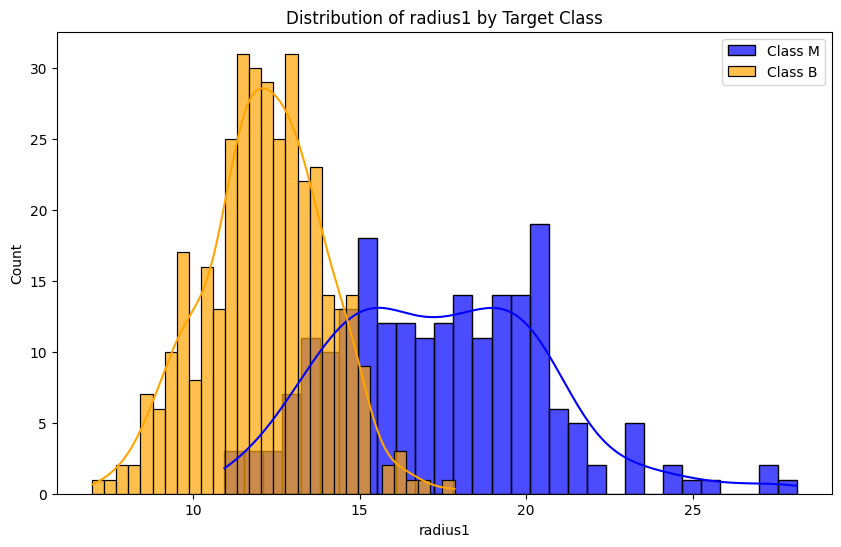

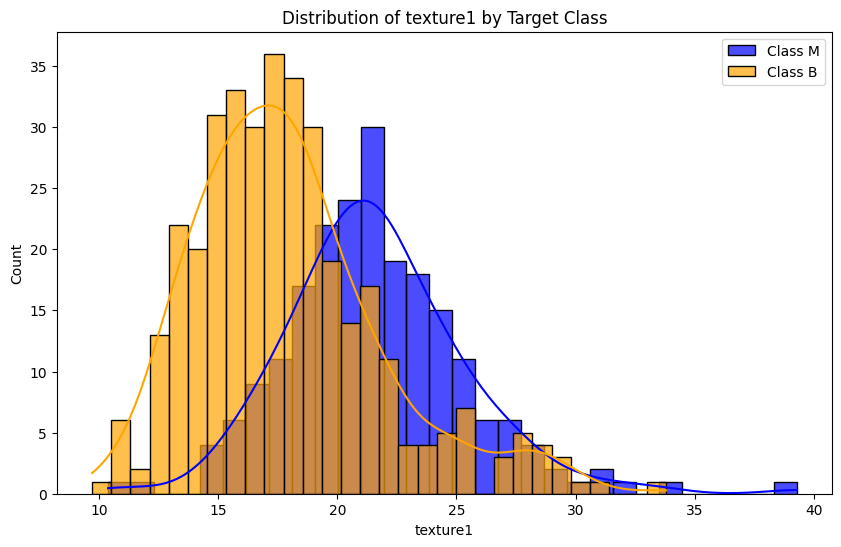

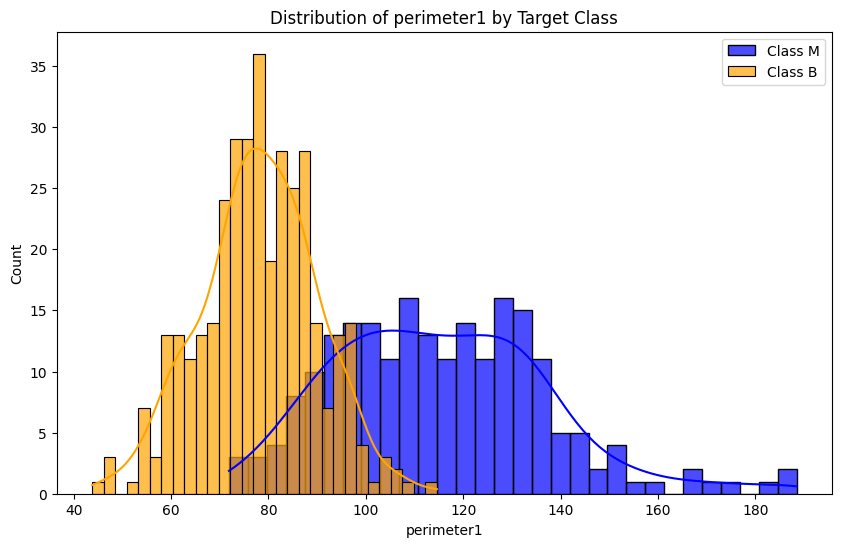

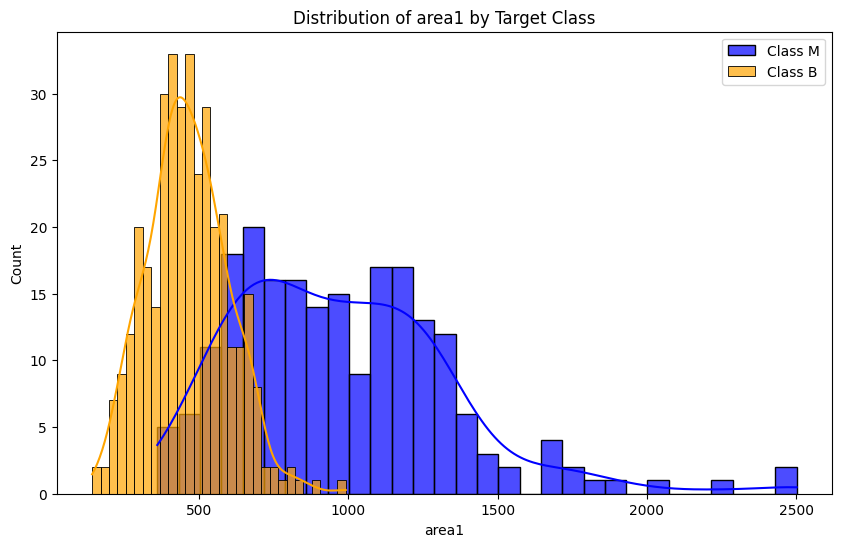

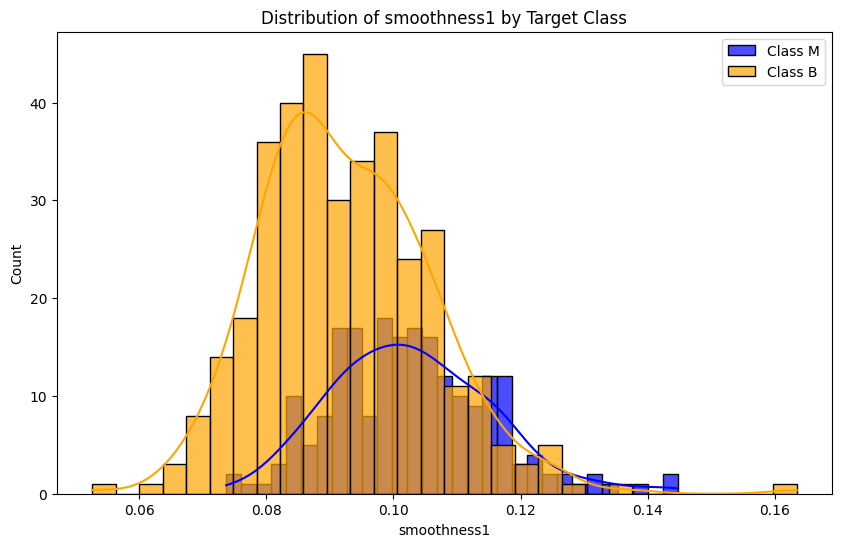

...

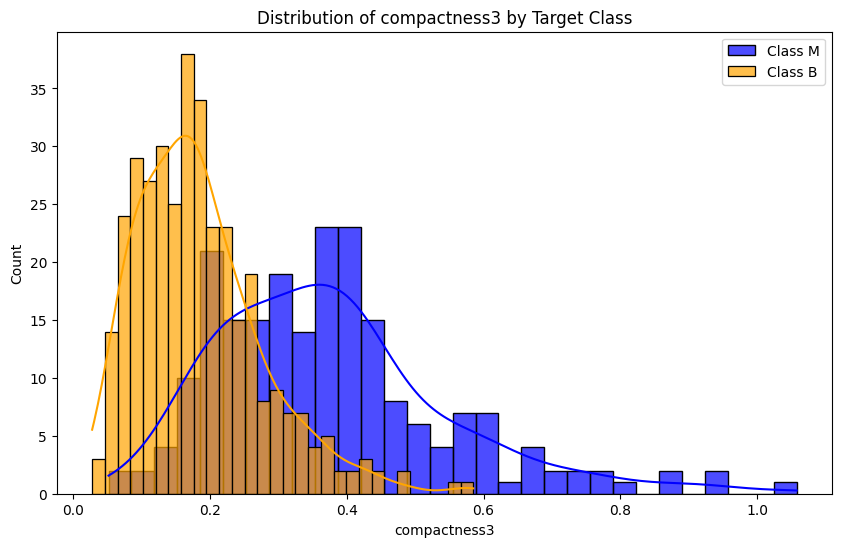

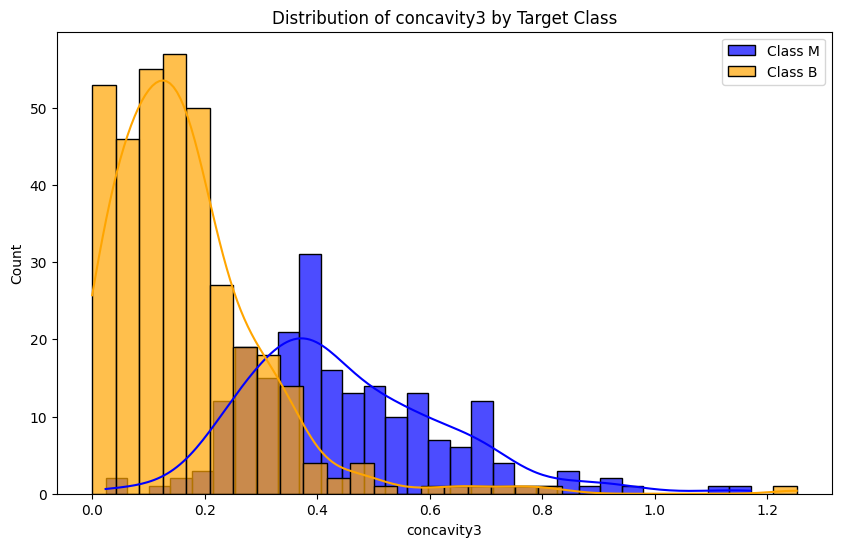

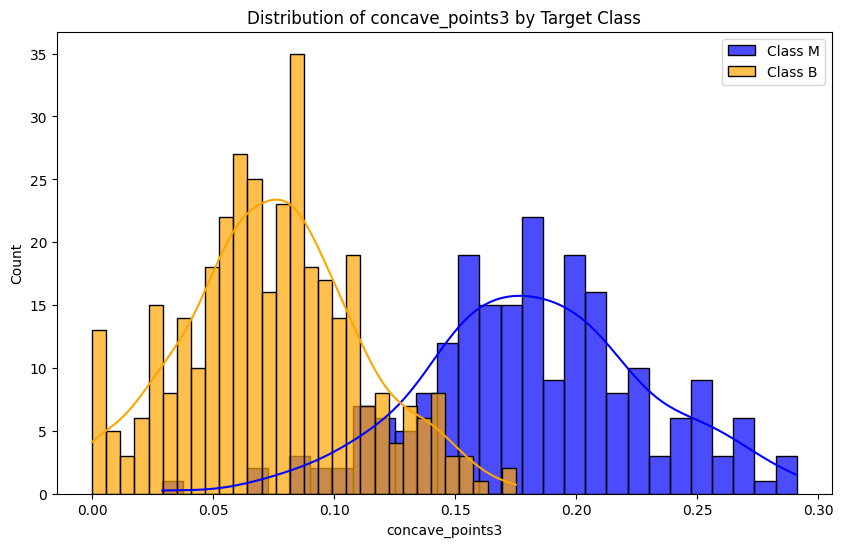

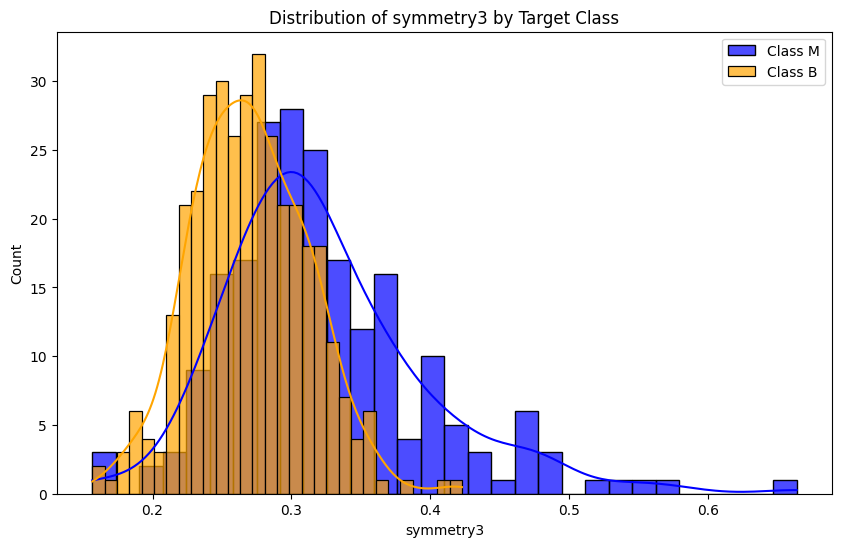

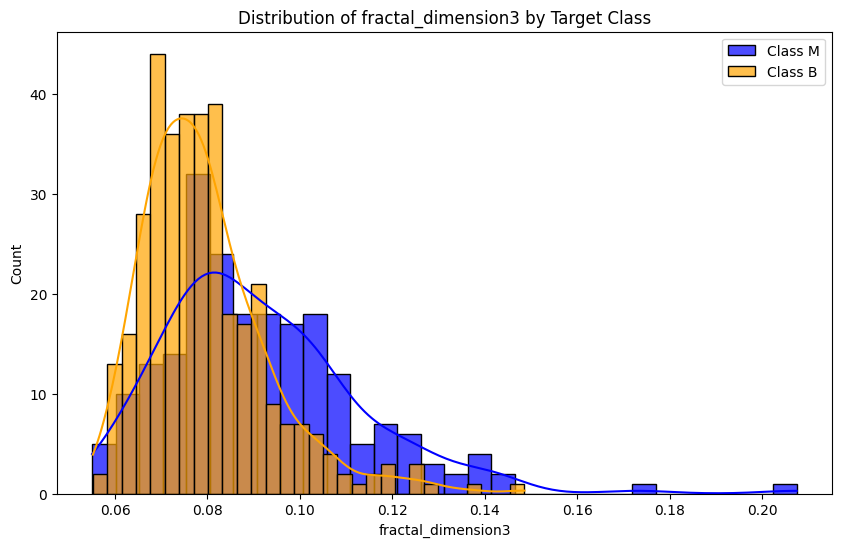

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns  # Optional, for a nicer style

# Assuming df is your DataFrame with features and the target variable
df_class_0 = df[df['diagnosis'] == 'M']  # Replace 'diagnosis' with your actual target variable name
df_class_1 = df[df['diagnosis'] == 'B']

# Loop through each feature and create bar charts
for feature in df.columns[:-1]:  # Exclude the target variable
    plt.figure(figsize=(10, 6))
    sns.histplot(df_class_0[feature], bins=30, color='blue', kde=True, label='Class M', alpha=0.7)
    sns.histplot(df_class_1[feature], bins=30, color='orange', kde=True, label='Class B', alpha=0.7)
    plt.title(f'Distribution of {feature} by Target Class')
    plt.xlabel(feature)
    plt.ylabel('Count')
    plt.legend()
    plt.show()


### Outliers

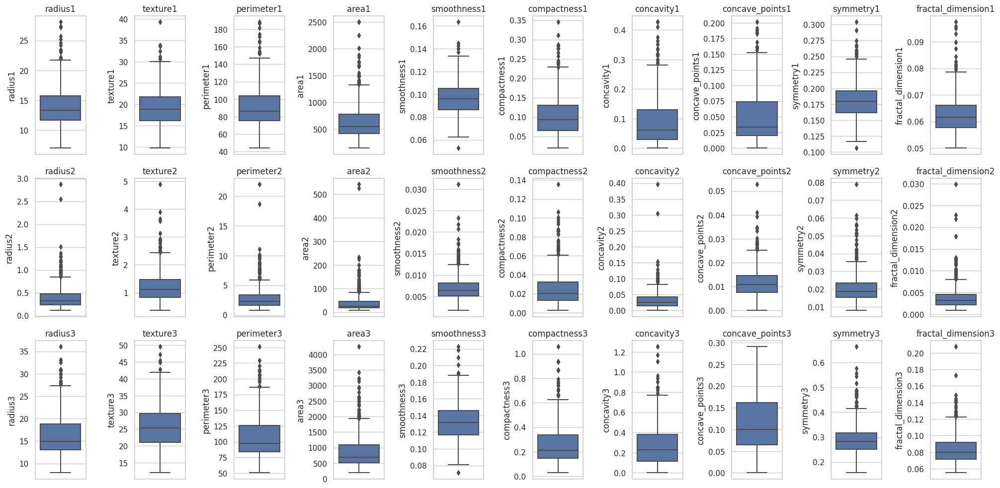

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming 'df' is your DataFrame

# Set the style of seaborn
sns.set(style="whitegrid")

# Box plot for each feature (all vertical)
plt.figure(figsize=(20, 10))
for i, col in enumerate(df.columns[:-1]):  # Exclude the 'diagnosis' column
    plt.subplot(3, 10, i + 1)
    sns.boxplot(y=df[col])
    plt.title(col)

plt.tight_layout()
plt.show()


In [ ]:
#label encoding for target variable

from sklearn import preprocessing
label_encoder = preprocessing.LabelEncoder()

df['diagnosis'] = label_encoder.fit_transform(y)
df['diagnosis'].unique()

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_label.py:116: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


array([1, 0])

## EDA Using Pytorch

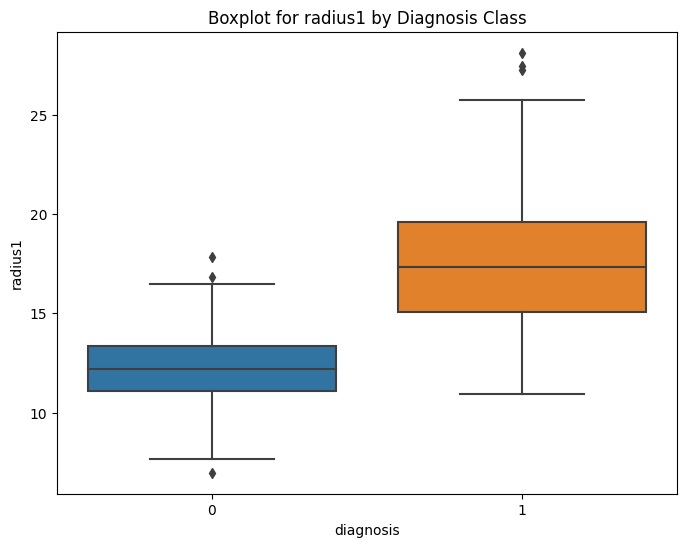

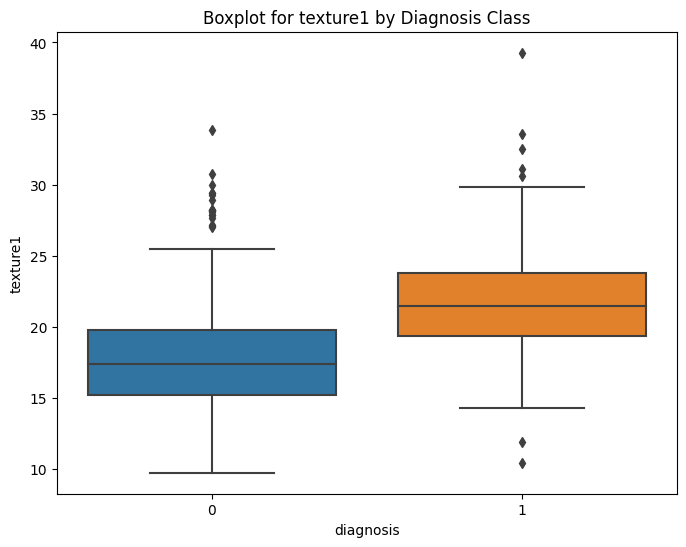

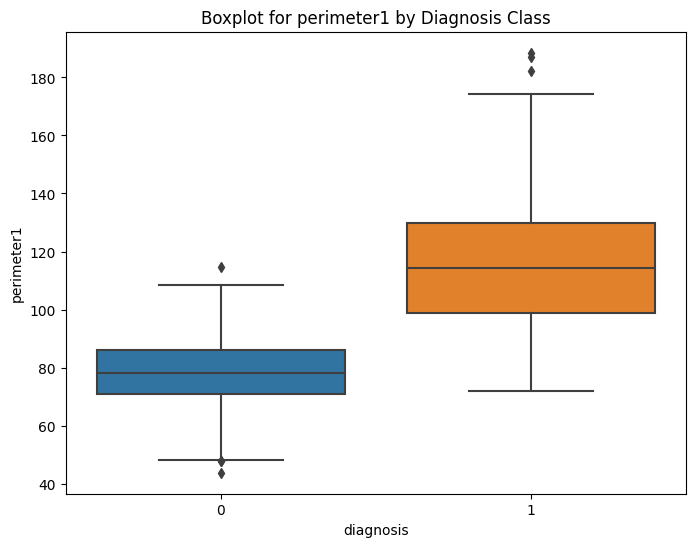

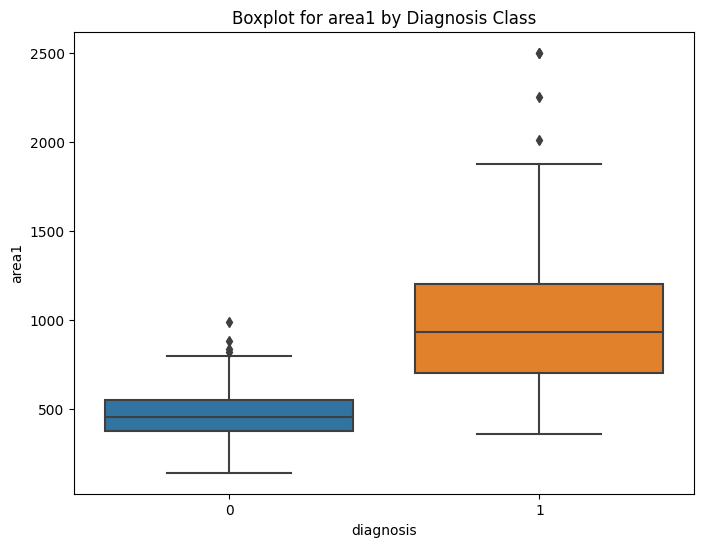

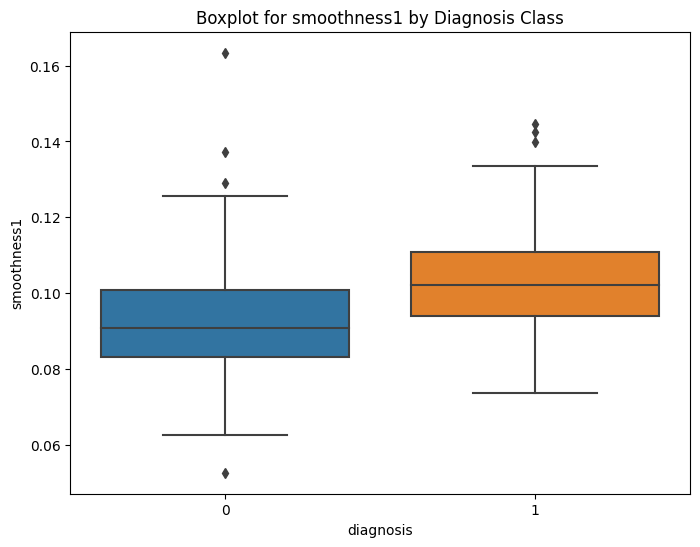

...

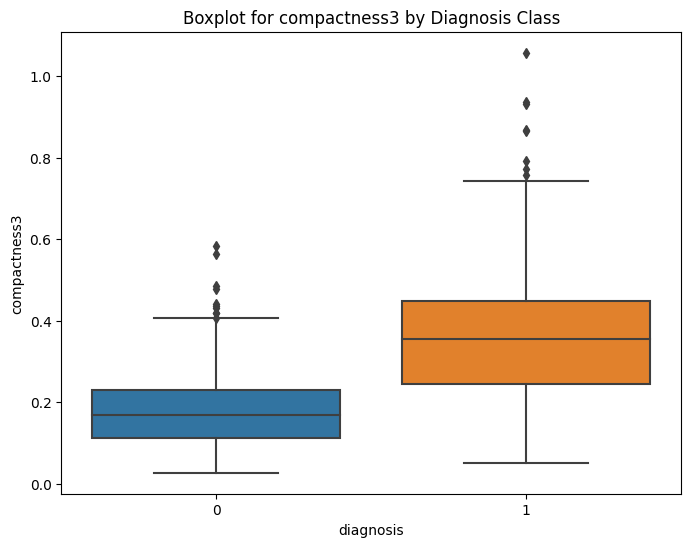

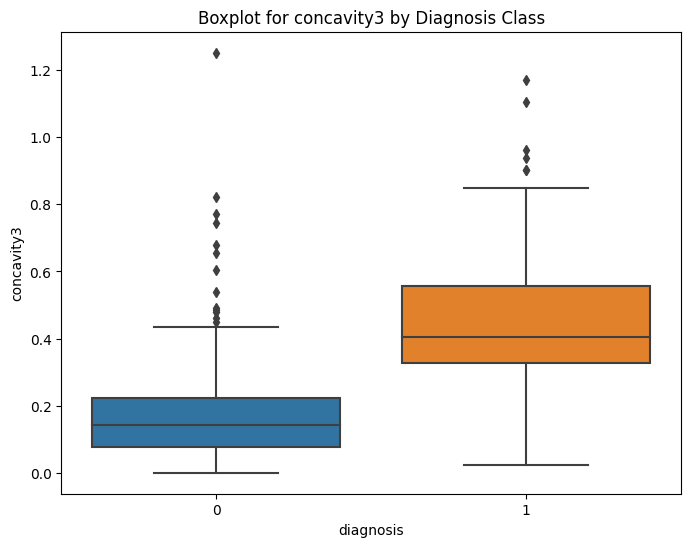

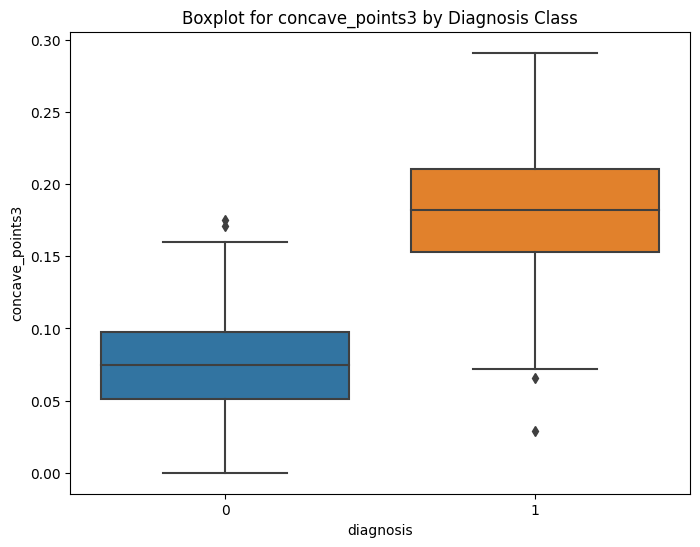

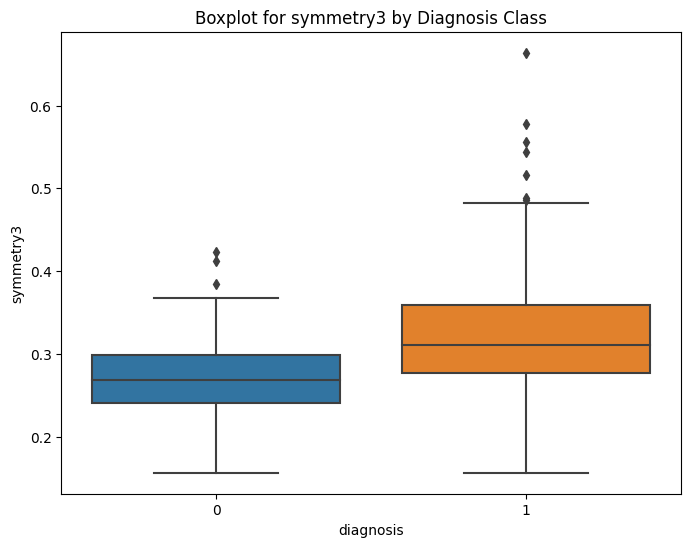

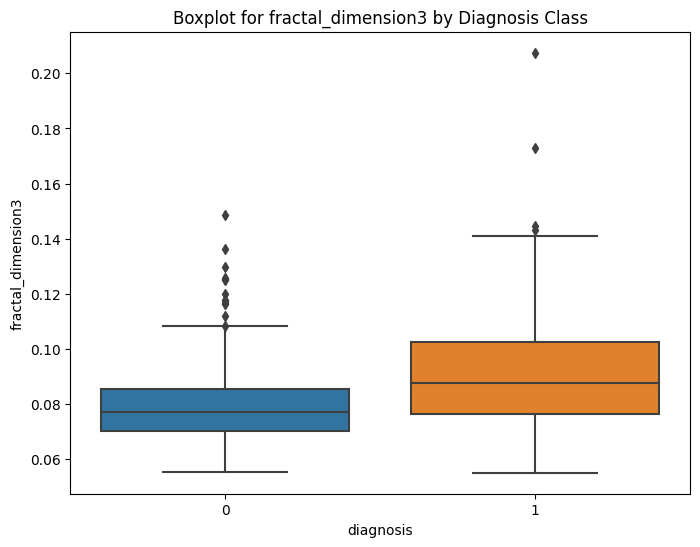

In [ ]:
# Convert to PyTorch tensors
X_train_tensor = torch.tensor(df.drop('diagnosis', axis=1).values, dtype=torch.float32)
y_train_tensor = torch.tensor(df['diagnosis'].values, dtype=torch.float32)

# Convert to pandas DataFrame for convenience
df_numeric = pd.DataFrame(X_train_tensor.numpy(), columns=df.columns[:-1])  # Assuming 'df' is your original DataFrame

# Pairplot for selected features (you can customize the features)
sns.pairplot(pd.concat([df_numeric, df['diagnosis']], axis=1), hue='diagnosis')
plt.show()


# Boxplot for individual features
for feature in df_numeric.columns:
    plt.figure(figsize=(8, 6))
    sns.boxplot(x='diagnosis', y=feature, data=pd.concat([df_numeric, df['diagnosis']], axis=1))
    plt.title(f'Boxplot for {feature} by Diagnosis Class')
    plt.show()


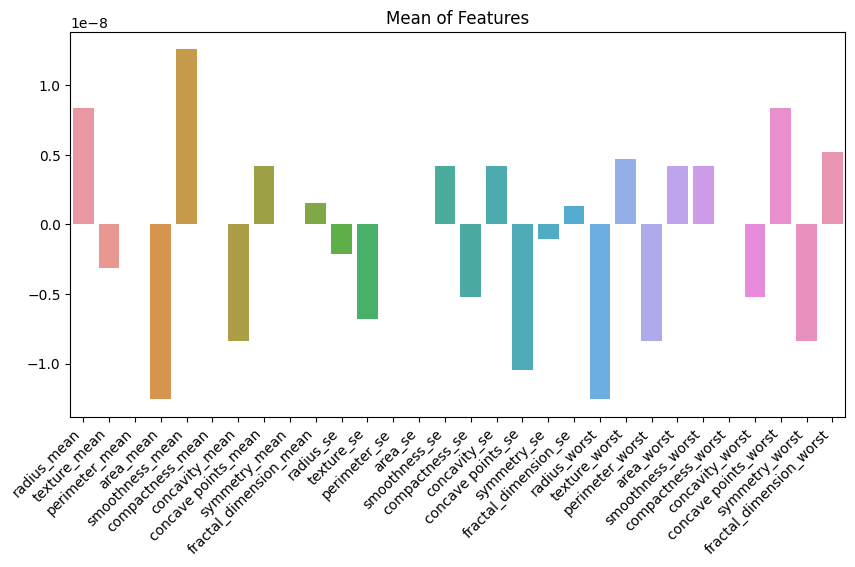

In [ ]:
# Convert NumPy arrays to PyTorch tensors
X_train_tensor = torch.tensor(X_train, dtype=torch.float32)

# Calculate the mean of features using PyTorch
mean_X_train = X_train_tensor.mean(dim=0)

# Visualize the mean of features
plt.figure(figsize=(10, 5))
sns.barplot(x=column_names[2:], y=mean_X_train.numpy())
plt.title('Mean of Features')
plt.xticks(rotation=45, horizontalalignment='right')
plt.show()


### Normalizing Data for handling Outliers

In [ ]:
# Robust Scaling to handle Outliers

# Separate features and target
X = df.drop('diagnosis', axis=1)
y = df['diagnosis']

# Create a StandardScaler
scaler = RobustScaler()

# Fit and transform the features
X_scaled = scaler.fit_transform(X)

# Convert the scaled features back to a DataFrame (optional)
df_scaled = pd.DataFrame(X_scaled, columns=X.columns)
df_scaled['diagnosis'] = y  # Add the target column back if needed


In [ ]:
df.head()

,radius1,texture1,perimeter1,area1,smoothness1,compactness1,concavity1,concave_points1,symmetry1,fractal_dimension1,...,texture3,perimeter3,area3,smoothness3,compactness3,concavity3,concave_points3,symmetry3,fractal_dimension3,diagnosis
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,1
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,1
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,1
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,1
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,1


### Correlation Matrix

Matrix plot

<Axes: >

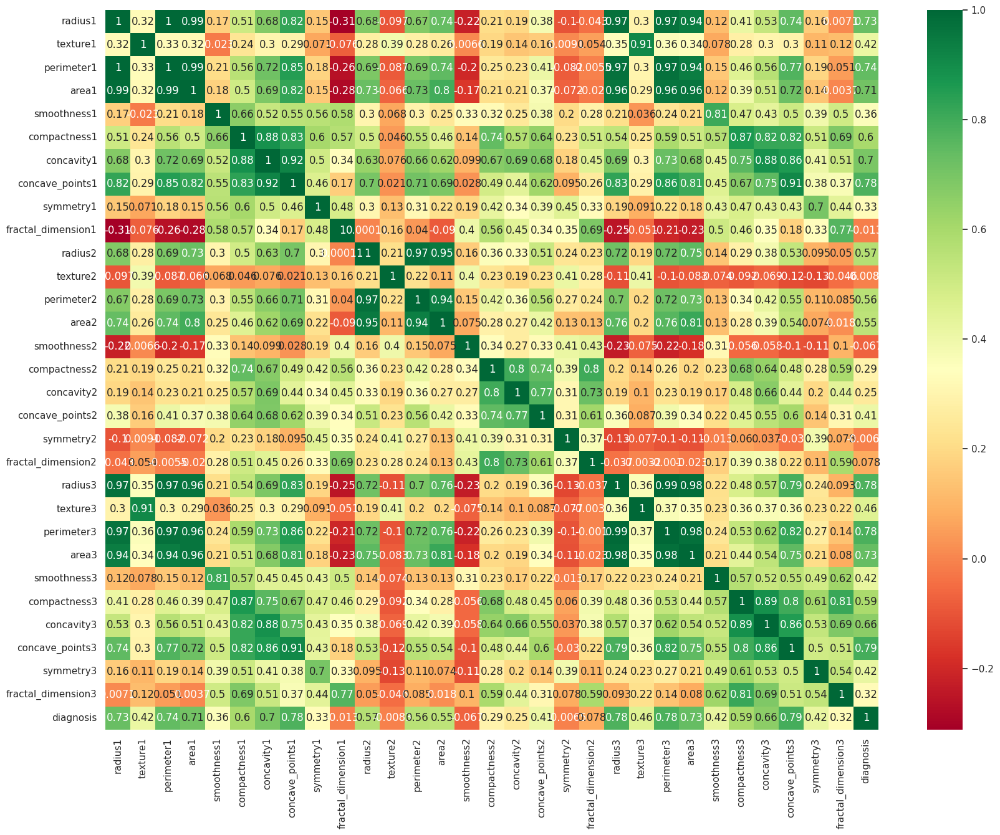

In [ ]:
plt.figure(figsize=[20,15])
sns.heatmap(df.corr(), annot = True, cmap= 'RdYlGn')

 **Fractal_dimension1, texture2, smoothness2, symmetry2, Fractal_dimension2 are very less co-related to target variable diagnosis**

**Correlation Graph**

All region shaded in Dark green shows high positive relation in the graph

Fractal_dimension1, texture2, smoothness2, symmetry2, Fractal_dimension2 are very less co-related to target variable diagnosis

Each radius, perimeter, area are almost high relation relation with 3 of them and sharing similar relations with each feature in the graph

### PCA

In [ ]:
from sklearn.decomposition import PCA

# Assuming 'selected_features' is a DataFrame containing the subset of features for PCA
selected_features = df[['radius1', 'perimeter1', 'area1', 'radius2', 'perimeter2', 'area2','radius3', 'perimeter3', 'area3']]


In [ ]:

# Perform PCA
pca = PCA(n_components= 3)
principal_components = pca.fit_transform(selected_features)

In [ ]:
df1=df.drop(columns=['radius1', 'perimeter1', 'area1', 'radius2', 'perimeter2', 'area2','radius3', 'perimeter3', 'area3'])
df1

,texture1,smoothness1,compactness1,concavity1,concave_points1,symmetry1,fractal_dimension1,texture2,smoothness2,compactness2,...,symmetry2,fractal_dimension2,texture3,smoothness3,compactness3,concavity3,concave_points3,symmetry3,fractal_dimension3,diagnosis
0,10.38,0.11840,0.27760,0.30010,0.14710,0.2419,0.07871,0.9053,0.006399,0.04904,...,0.03003,0.006193,17.33,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890,1
1,17.77,0.08474,0.07864,0.08690,0.07017,0.1812,0.05667,0.7339,0.005225,0.01308,...,0.01389,0.003532,23.41,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902,1
2,21.25,0.10960,0.15990,0.19740,0.12790,0.2069,0.05999,0.7869,0.006150,0.04006,...,0.02250,0.004571,25.53,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758,1
3,20.38,0.14250,0.28390,0.24140,0.10520,0.2597,0.09744,1.1560,0.009110,0.07458,...,0.05963,0.009208,26.50,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300,1
4,14.34,0.10030,0.13280,0.19800,0.10430,0.1809,0.05883,0.7813,0.011490,0.02461,...,0.01756,0.005115,16.67,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,22.39,0.11100,0.11590,0.24390,0.13890,0.1726,0.05623,1.2560,0.010300,0.02891,...,0.01114,0.004239,26.40,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115,1
565,28.25,0.09780,0.10340,0.14400,0.09791,0.1752,0.05533,2.4630,0.005769,0.02423,...,0.01898,0.002498,38.25,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637,1
566,28.08,0.08455,0.10230,0.09251,0.05302,0.1590,0.05648,1.0750,0.005903,0.03731,...,0.01318,0.003892,34.12,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820,1
567,29.33,0.11780,0.27700,0.35140,0.15200,0.2397,0.07016,1.5950,0.006522,0.06158,...,0.02324,0.006185,39.42,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400,1


In [ ]:

# Combine principal components with the original dataset
df_combined = pd.concat([df1, pd.DataFrame(principal_components, columns=['dim1', 'dim2','dim3'])], axis=1)

# Use 'combined_df' for further analysis

In [ ]:
df_combined.head()

,texture1,smoothness1,compactness1,concavity1,concave_points1,symmetry1,fractal_dimension1,texture2,smoothness2,compactness2,...,smoothness3,compactness3,concavity3,concave_points3,symmetry3,fractal_dimension3,diagnosis,dim1,dim2,dim3
0,10.38,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,0.9053,0.006399,0.04904,...,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,1,1160.195636,-294.137287,48.025411
1,17.77,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,0.7339,0.005225,0.01308,...,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,1,1269.141789,15.538195,-35.631659
2,21.25,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,0.7869,0.006150,0.04006,...,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,1,995.797080,39.116766,-1.793435
3,20.38,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,1.1560,0.009110,0.07458,...,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,1,-407.188861,-67.352933,8.729461
4,14.34,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,0.7813,0.011490,0.02461,...,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,1,930.386417,189.180456,1.049468


### Split train test data and check Feture Importance

In [ ]:
X = df_combined.drop('diagnosis', axis=1)
y = df_combined['diagnosis']

In [ ]:
#Spliting dataset into train and test data

from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

<Axes: >

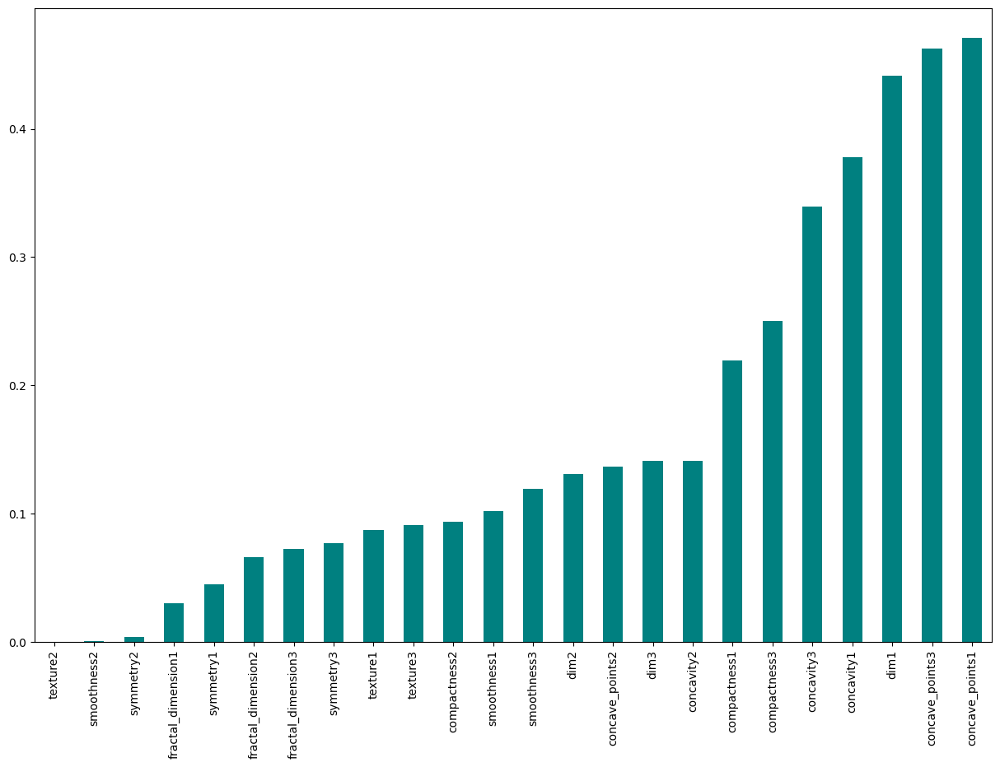

In [ ]:
#calculate information gain of each variable in the context of the target variable.

from sklearn.feature_selection import mutual_info_classif

infor_gain = mutual_info_classif(X_train, y_train)
feature_importance = pd.Series(infor_gain, X_train.columns)
feature_importance.sort_values().plot.bar(figsize=(15,10), color = 'teal')

### Model Implementation

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.metrics import confusion_matrix
from torch.utils.data import DataLoader, TensorDataset

In [ ]:
X_train_array = X_train.values  # Convert DataFrame to NumPy array
X_train_tensor = torch.tensor(X_train_array, dtype=torch.float32)
X_test_array = X_test.values
X_test_tensor = torch.tensor(X_test_array, dtype=torch.float32)


In [ ]:
# Assuming y_train and y_test are your pandas Series
y_train_tensor = torch.tensor(y_train.values, dtype=torch.float32)
y_test_tensor = torch.tensor(y_test.values, dtype=torch.float32)

In [ ]:
train_data = TensorDataset(X_train_tensor, y_train_tensor)
train_loader = DataLoader(train_data, batch_size=32, shuffle=True)


In [ ]:
class BinaryClassificationModel(nn.Module):
    def __init__(self, input_size):
        super(BinaryClassificationModel, self).__init__()
        self.fc1 = nn.Linear(input_size, 64)
        self.fc2 = nn.Linear(64, 50)  # Corrected the input size for fc2
        self.fc3 = nn.Linear(50, 1)
        self.relu = nn.ReLU()
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        x = self.relu(self.fc1(x))
        x = self.relu(self.fc2(x))
        x = self.sigmoid(self.fc3(x))
        return x

In [ ]:
input_size = X_train.shape[1]  # Replace this with the actual input size

### Implementation testing:

In [ ]:

## 10 epochs and LR= 0.01
## optimizer ADAM

In [ ]:

model = BinaryClassificationModel(input_size)

criterion = nn.BCELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

In [ ]:
epochs = 10
for epoch in range(epochs):
    for inputs, labels in train_loader:
        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)
        loss.backward()
        optimizer.step()

In [ ]:
# Evaluate the model
with torch.no_grad():
    model.eval()
    test_outputs = model(X_test_tensor)
    test_outputs = test_outputs.squeeze().detach().numpy()

In [ ]:
# Assuming y_test_tensor is the ground truth labels for test data
predicted_labels = (test_outputs > 0.5).astype(int)  # Converting probabilities to 0 or 1

# Calculate accuracy
accuracy = (predicted_labels == y_test_tensor.numpy()).mean()
print(f"Accuracy: {accuracy * 100:.2f}%")

Accuracy: 92.98%


In [ ]:
from sklearn.metrics import precision_recall_fscore_support

precision, recall, f1_score, _ = precision_recall_fscore_support(
    y_test_tensor.numpy(), predicted_labels, average='binary'
)

print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1-score: {f1_score:.4f}")

Precision: 0.8974
Recall: 0.8974
F1-score: 0.8974


### Check for best Learning Rate with ADAM optimizer

In [ ]:
from sklearn.metrics import accuracy_score, precision_recall_fscore_support


learning_rates = [0.001, 0.01, 0.1]

for lr in learning_rates:
    model = BinaryClassificationModel(input_size)
    criterion = nn.BCELoss()
    optimizer = optim.Adam(model.parameters(), lr=lr)

    for epoch in range(epochs):
        for inputs, labels in train_loader:
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)
            loss.backward()
            optimizer.step()

    with torch.no_grad():
        model.eval()
        test_outputs = model(X_test_tensor)
        test_outputs = test_outputs.squeeze().detach().numpy()

        predicted_labels = (test_outputs > 0.5).astype(int)
        accuracy = accuracy_score(y_test_tensor.numpy(), predicted_labels)

        precision, recall, f1_score, _ = precision_recall_fscore_support(
            y_test_tensor.numpy(), predicted_labels, average='binary'
        )
        print("---------------------------------------------")
        print(f"Learning Rate: {lr}")
        print(f"Accuracy: {accuracy * 100:.2f}%")
        print(f"Precision: {precision:.4f}")
        print(f"Recall: {recall:.4f}")
        print(f"F1-score: {f1_score:.4f}")

---------------------------------------------
Learning Rate: 0.001
Accuracy: 92.98%
Precision: 0.9189
Recall: 0.8718
F1-score: 0.8947
---------------------------------------------
Learning Rate: 0.01
Accuracy: 93.86%
Precision: 0.9000
Recall: 0.9231
F1-score: 0.9114
---------------------------------------------
Learning Rate: 0.1
Accuracy: 34.21%
Precision: 0.3421
Recall: 1.0000
F1-score: 0.5098


### Check for best epochs for ADAM optimizer at LR= 0.01

Accuracy for 500 epochs: 92.98%
Accuracy for 1000 epochs: 93.86%
Accuracy for 2000 epochs: 95.61%


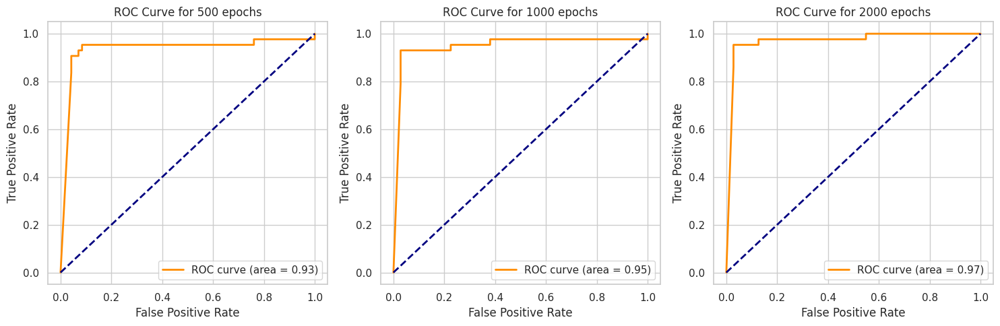

In [ ]:
from sklearn.metrics import roc_curve, auc

# Define the number of epochs
epochs = [500, 1000, 2000]  # Define different epochs here

# Create subplots
fig, axs = plt.subplots(1, len(epochs), figsize=(15, 5))

for i, epoch in enumerate(epochs):
    # Instantiate the model for each epoch value
    model = BinaryClassificationModel(input_size)

    # Define loss function and optimizer
    criterion = nn.BCELoss()
    optimizer = optim.Adam(model.parameters(), lr=0.01)

    # Train the model for the current epoch value
    for e in range(epoch):
        for inputs, labels in train_loader:
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)
            loss.backward()
            optimizer.step()

    # Evaluate the model after training for the current epoch value
    with torch.no_grad():
        model.eval()
        test_outputs = model(X_test_tensor)
        test_outputs = test_outputs.squeeze().detach().numpy()

        # Calculate accuracy for the current model
        predicted_labels = (test_outputs > 0.5).astype(int)
        accuracy = (predicted_labels == y_test_tensor.numpy()).mean()
        print(f"Accuracy for {epoch} epochs: {accuracy * 100:.2f}%")

        fpr, tpr, _ = roc_curve(y_test_tensor.numpy(), test_outputs)
        roc_auc = auc(fpr, tpr)

        # Plot ROC curve for the current epoch value
        axs[i].plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
        axs[i].plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
        axs[i].set_xlabel('False Positive Rate')
        axs[i].set_ylabel('True Positive Rate')
        axs[i].set_title(f'ROC Curve for {epoch} epochs')
        axs[i].legend(loc="lower right")

# Adjust layout
plt.tight_layout()
plt.show()


### Check for best Learning rate with SGD Optimizer

In [ ]:
from sklearn.metrics import accuracy_score, precision_recall_fscore_support

learning_rates = [0.001, 0.01, 0.1]

for lr in learning_rates:
    model = BinaryClassificationModel(input_size)
    criterion = nn.BCELoss()
    optimizer = optim.SGD(model.parameters(), lr=lr)

    for epoch in epochs:
        for inputs, labels in train_loader:
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)
            loss.backward()
            optimizer.step()

    with torch.no_grad():
        model.eval()
        test_outputs = model(X_test_tensor)
        test_outputs = test_outputs.squeeze().detach().numpy()

        predicted_labels = (test_outputs > 0.5).astype(int)
        accuracy = accuracy_score(y_test_tensor.numpy(), predicted_labels)

        precision, recall, f1_score, _ = precision_recall_fscore_support(
            y_test_tensor.numpy(), predicted_labels, average='binary'
        )
        print("---------------------------------------------")
        print(f"Learning Rate: {lr}")
        print(f"Accuracy: {accuracy * 100:.2f}%")
        print(f"Precision: {precision:.4f}")
        print(f"Recall: {recall:.4f}")
        print(f"F1-score: {f1_score:.4f}")


---------------------------------------------
Learning Rate: 0.001
Accuracy: 92.98%
Precision: 0.8974
Recall: 0.8974
F1-score: 0.8974
---------------------------------------------
Learning Rate: 0.01
Accuracy: 88.60%
Precision: 0.9333
Recall: 0.7179
F1-score: 0.8116
---------------------------------------------
Learning Rate: 0.1
Accuracy: 65.79%
Precision: 0.0000
Recall: 0.0000
F1-score: 0.0000


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


### Check for best epochs with SGD Optimizer

Accuracy for 500 epochs: 92.11%
Accuracy for 1000 epochs: 93.86%
Accuracy for 2000 epochs: 92.98%


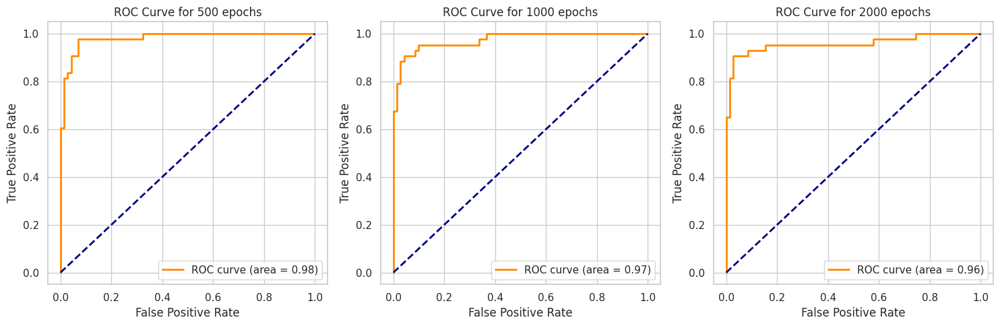

In [ ]:
from sklearn.metrics import roc_curve, auc

# Define the number of epochs
epochs = [500, 1000, 2000]  # Define different epochs here

# Create subplots
fig, axs = plt.subplots(1, len(epochs), figsize=(15, 5))

for i, epoch in enumerate(epochs):
    # Instantiate the model for each epoch value
    model = BinaryClassificationModel(input_size)

    # Define loss function and optimizer
    criterion = nn.BCELoss()
    optimizer = optim.SGD(model.parameters(), lr=0.001)

    # Train the model for the current epoch value
    for e in range(epoch):
        for inputs, labels in train_loader:
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs.squeeze(), labels)
            loss.backward()
            optimizer.step()

    # Evaluate the model after training for the current epoch value
    with torch.no_grad():
        model.eval()
        test_outputs = model(X_test_tensor)
        test_outputs = test_outputs.squeeze().detach().numpy()

        # Calculate accuracy for the current model
        predicted_labels = (test_outputs > 0.5).astype(int)
        accuracy = (predicted_labels == y_test_tensor.numpy()).mean()
        print(f"Accuracy for {epoch} epochs: {accuracy * 100:.2f}%")

        fpr, tpr, _ = roc_curve(y_test_tensor.numpy(), test_outputs)
        roc_auc = auc(fpr, tpr)

        # Plot ROC curve for the current epoch value
        axs[i].plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
        axs[i].plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
        axs[i].set_xlabel('False Positive Rate')
        axs[i].set_ylabel('True Positive Rate')
        axs[i].set_title(f'ROC Curve for {epoch} epochs')
        axs[i].legend(loc="lower right")

# Adjust layout
plt.tight_layout()
plt.show()


### Confusion Mtrix with Best Performing ADAM optimizer with LR= 0.01 and epochs = 1000

---------------------------------------------
Learning Rate: 0.01
Epochs: 1000
Accuracy: 97.37%
Precision: 0.9592
Recall: 0.9792
F1-score: 0.9691
Confusion Matrix:
[[64  2]
 [ 1 47]]


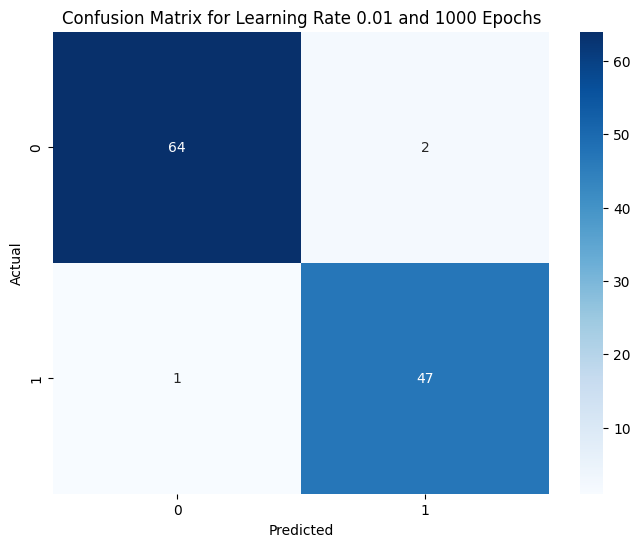

In [ ]:
from sklearn.metrics import confusion_matrix, accuracy_score, precision_recall_fscore_support

# Set the learning rate and epochs
lr = 0.01
epochs = 1000

# Train the model
for epoch in range(epochs):
    for inputs, labels in train_loader:
        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)
        loss.backward()
        optimizer.step()

# Evaluate the model
with torch.no_grad():
    model.eval()
    test_outputs = model(X_test_tensor)
    test_outputs = test_outputs.squeeze().detach().numpy()

    predicted_labels = (test_outputs > 0.5).astype(int)
    accuracy = accuracy_score(y_test_tensor.numpy(), predicted_labels)

    precision, recall, f1_score, _ = precision_recall_fscore_support(
        y_test_tensor.numpy(), predicted_labels, average='binary'
    )

    # Compute the confusion matrix
    cm = confusion_matrix(y_test_tensor.numpy(), predicted_labels)



    print(f"Learning Rate: {lr}")
    print(f"Epochs: {epochs}")
    print(f"Accuracy: {accuracy * 100:.2f}%")
    print(f"Precision: {precision:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"F1-score: {f1_score:.4f}")
    print("Confusion Matrix:")
    print(cm)

    # Visualize the confusion matrix using seaborn
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['0', '1'], yticklabels=['0', '1'])
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.title(f'Confusion Matrix for Learning Rate {lr} and {epochs} Epochs')
    plt.show()


Confusion Matrix represent TP and TN (64 and 47) are higher than False interpretation so we can say model is working well.

### Conclusion:

**Implementation with ADAM Optimizer:**
- For Learning Rate (LR) of [0.1, 0.01, 0.001] it is noticed that LR oh 0.01
  giving best score of 93.86% and f1-score of 91% also precision and recall both above 90% while other 0.1 is very less and 0.001 is closer to 0.01 every time.

- For differents Epochs of [500, 1000, 2000] it is noticed that epochs of 2000 is performing best with 96% accuracy while epochs of 1000 and less are less


**Implementation with SGD Optimizer:**
- For Learning Rate (LR) of [0.1, 0.01, 0.001] it is noticed that LR oh 0.001
  giving best score of 92.98% and f1-score of 90% also precision and recall both above 89% while other 0.1 is very less and 0.001 is closer to 0.01 every time.

- For differents Epochs of [500, 1000, 2000] it is noticed that epochs of 2000 is performing best with 93.98% accuracy while epochs of 1000 and less are less

